In [1]:
# -*- coding: utf-8 -*-

'''
@Author   :   Corley Tang
@contact  :   cutercorleytd@gmail.com
@Github   :   https://github.com/corleytd
@Time     :   2023-04-11 22:02
@Project  :   Hands-on Deep Learning with PyTorch-image_processing_and_convolutional_neural_network
图像处理与卷积神经网络
'''

import cv2 as cv
import numpy as np
import torch
from matplotlib import pyplot as plt
from torch import nn

# 设置随机种子
torch.manual_seed(20230411)

## 1.计算机视觉概述
计算机视觉（Computer Vision，简写为CV）是一门研究如何让计算机从图像或图像序列中获取信息并理解其信息的学科，其主要目的在于从图像或图像序列中提取对世界的描述。从工程学的角度来看，它研究如何使用算法模拟人类的视觉系统，从而完成人类的通过视觉可以完成的一系列工作，其中最广为人知的应用就是“人脸识别”。
作为深度学习相关的、近二十年内落地发展最快的领域之一，计算机视觉是炙手可热的领域：
1. 计算机视觉领域非常有趣并且具有改变世界的潜力。人脑所获取的信息有80%都依赖视觉形成，成功模拟人类视觉系统所带来的经济与社会效益是不可估量的，从科学精神上来说，计算机视觉值得科研人员付出一生去研究，进入这个领域，就有机会拥有自己的事业（career），而不只是一份工作（job）
2. 21世纪初，计算机视觉领域取得了飞速的发展、并拥有了巨量实际落地场景，这意味着这个领域有产业需求、有学术潜力，并且最重要的是，有很高的经济价值。

但也是充满争议的领域：
1. 门槛低，上限高，学习曲线陡峭
2. 计算机视觉 ≠ 卷积神经网络
  - 计算机视觉所覆盖的领域远远超出CNN本身，卷积只是冰山一角
  - 以卷积神经网络为核心的“深度视觉”是一个过于年轻的领域，这个领域最稀缺的是开拓者

早在深度学习兴起之前，计算机视觉就是一个理论成熟、内容繁多的跨学科领域。计算机视觉有完备的知识体系，它的内容包括了摄像设备性能、成像原理等图像获取和生成技术、也包括视频特效、3D、图像复原等早就被广泛应用的视频/图像处理技术，同时还包括图像分割、图像识别等让计算机分析、理解图像的技术。其中，图像处理也叫做“图像特征提取”，这项技术高度依赖数学、几何、光学等基础学科，与信号处理等学科有较多交叉，是计算机视觉中非常关键的领域。在人工智能兴起之后，传统计算机视觉中图像处理、图像分析领域的许多工作都可以由神经网络来完成，并且当数据量和计算资源足够时，神经网络往往能比传统方法取得更好的效果，人工智能与计算机视觉的交叉学科深度视觉由此诞生，它是使用深度学习相关的技术、让计算机从图像或图像序列中获取信息并理解其信息的学科。而其中最令人瞩目的研究成果就是以卷积神经网络为核心的一系列模型架构。但是，在卷积神经网络压倒性的效果和性能下，行业并没有放弃传统计算机视觉，整个行业的人才标准也偏向于视觉人才与人工智能人才的融合，而不是传统视觉人才被“替代”。如今，计算机视觉工程师都必须掌握神经网络，但同时还是需要掌握传统视觉相关的技能。深度视觉没有能够实现彻底地颠覆传统计算机视觉，主要原因如下：
1. 深度视觉训练成本太高，而传统视觉方法成本低廉
2. 深度视觉算法的进步和提升，需要传统视觉理论的支持

深度视觉是一个非常非常年轻的领域：卷积神经网络首次在图像识别任务中引发轰动是2012年，并且绝大多数现在广为使用的深度视觉模型都诞生在2014之后，因此这个领域理论基础薄弱、缺乏权威性、缺乏积累、高度依赖于个人经验。在这个领域里，许多有用的做法没有坚实的理论基础（比如Batch Normalization），而一些理论在实际中又毫无用处，虽然被证明有用的东西也很多，但它们之间又缺乏联系。这个领域最需要的是向未知的方向突破，不断地推动人类知识的边界的能力，计算机视觉人才必须有较好的研究素养，有较强的英文、数学、文献阅读以及工程能力，才能够理解各种探索的原理甚至提出探索的方案。只有能够产出研究成果，才有可能推进技术的实际落地，为企业创造价值。读万篇文献、码万行代码，之后才有可能独当一面、成为能够统领视觉项目的技术领袖。

随着计算机视觉算法的进步，实际落地场景是越来越多的，可探索的方向也十分丰富，只要你具备一定的研究能力，并且有心在这个领域深耕下去，机会和红利是越来越多的。视觉问题无处不在，其应用的广泛程度远远超出人们的想象，并且各个领域都有了一些独特的理论基础与实践方法，如YOLO库等。也有一些耳熟能详的应用方向，如目标检测、人脸识别、语义分割、风格迁移、文本生成图像等。文章[https://viso.ai/applications/computer-vision-applications/](https://viso.ai/applications/computer-vision-applications/)总结了计算机视觉的超过100种应用场景，涵盖了体育、医疗、农业、交通运输、零售和制造业等领域。
## 2.图像的基本操作
图像的传统操作需要安装专门用于处理图像的OpenCV库，通过命令`pip install opencv-python`进行安装即可。
### 图像的基本表示
下面先用OpenCV库打开一张图预览效果。

In [2]:
# 读取本地图片
img = cv.imread('../data/imgs/avatar_beauty.png')
img

array([[[239, 237, 236],
        [239, 237, 236],
        [239, 237, 236],
        ...,
        [213, 197, 180],
        [214, 198, 181],
        [214, 198, 181]],

       [[239, 237, 236],
        [239, 237, 236],
        [239, 237, 236],
        ...,
        [217, 201, 185],
        [219, 203, 187],
        [220, 204, 188]],

       [[239, 237, 236],
        [239, 237, 236],
        [239, 237, 236],
        ...,
        [222, 205, 192],
        [223, 206, 193],
        [225, 208, 195]],

       ...,

       [[193, 179, 161],
        [194, 180, 162],
        [196, 182, 164],
        ...,
        [120,  97,  71],
        [119,  96,  70],
        [119,  96,  70]],

       [[194, 180, 162],
        [195, 181, 163],
        [196, 182, 164],
        ...,
        [118,  95,  69],
        [118,  95,  69],
        [118,  95,  69]],

       [[195, 181, 163],
        [195, 181, 163],
        [197, 183, 165],
        ...,
        [118,  93,  67],
        [119,  94,  68],
        [120,  95,  69]]

In [3]:
# 查看维度
img.shape

(1037, 2048, 3)

可以看到，读取的图像在计算机中的基本结构是一个三维Tensor或者三维矩阵表示，其3个维度分别是高度Height、宽度Width、通道Channel，高度和宽度往往排列在一起，两者共同决定图像的尺寸大小，如上面的图在竖直方向有1037个像素点、水平方向上有2048个像素点，共有1037*2048=2123776个像素点。通道是单独的维度，通常排在高度宽度之后，也有可能排在第一位，它决定图像中的轮廓、线条、色彩，基本决定了图像中显示的所有内容，尤其是颜色，因此又叫做色彩空间。在计算机的世界里，用于构成其他颜色的基础色彩，就叫做“通道”，最常用的三种基本颜色是红绿蓝（Red, Green, Blue, 简写为RGB），最常用的通道就是RGB通道，通过将红绿蓝混在一起，创造丰富的色彩。通道就是和原图尺寸一致、像素点数量一致的、只能够显示其通道颜色的图像，红色通道只能显示红色、绿色通道只能显示绿色、蓝色通道只能显示蓝色。在通道的每一个像素点上，都有[0,255]之间的整数值，这些整数值代表了“该通道上颜色的灰度”，“灰度”就是明亮程度，数字越接近255，就代表颜色明亮程度越高，越接近通道本身的颜色，数字越接近0，就代表颜色的明亮程度越弱，也就是越接近黑色，图示如下：
![rgb_channels](../assets/rgb_channels.png)

常见的通道类型如下：
1. 灰度通道：灰度通道不是指图像是灰色的通道，而是只有一种颜色的通道，灰度图像是只有一个通道的图像，RGB通道中的任意一个通道单独拿出来之后，都可以用灰度（明暗）来显示。通道数为1。
2. RGB色彩空间：数字世界最常见的彩色通道，分别表示红、绿、蓝三种电子成像的基本颜色。
3. CMYK色彩空间：用于彩色打印机成像的通道，由青色（Cyan）、品红（Magenta）、黄色（Yellow）和黑色（Black）构成，因此是四维通道，在图像结构中会显示为(高度，宽度，4)。
4. HSV（或HSL）色彩空间：HSV通道是为人们描述和解释颜色而创建的，H代表色相，S代表饱和度，V代表亮度。
5. RGBA色彩空间：也拥有四维通道，分别是红色、绿色、蓝色、透明度alpha、透明度alpha的取值范围在0-1之间、一种RGB颜色加上透明度之后，色彩就会变得“透明”，RGBA可以提供更丰富的色彩样式，让图像的色彩变得更加绚丽。

中间3种空间可以自由切换，但是也会产生数据损失，在OpenCV中也有支持切换的函数可以调用。在图像的矩阵中，可以使用索引找出任意像素的三个通道上的颜色的明度，通道上像素的灰度值也就是矩阵中的值几乎100%决定了图像所呈现出的内容，因此只要能够操作像素，就能够改变图像，这是图像能够被“处理”的基本条件。

In [4]:
img[0, 0, :]  # 第0行、第0列的像素点上的RGB3个通道值，位于图片左上角，同时都比较接近255，所以颜色较亮

array([239, 237, 236], dtype=uint8)

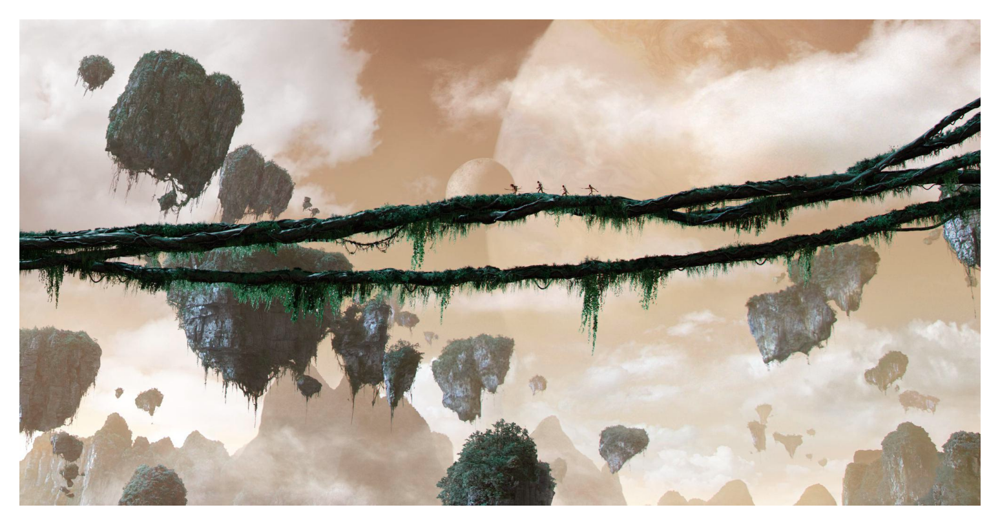

In [5]:
# 展示图片
plt.figure(dpi=300)  # 设置分辨率
plt.imshow(img)
plt.axis('off')  # 不显示坐标轴
plt.show()

图片可以显示，但是可以发现，图片的颜色不太对劲，这是因为OpenCV默认读取后的图像通道是BGR，因此需要将图像的通道顺序转换为RGB才能正常显示。

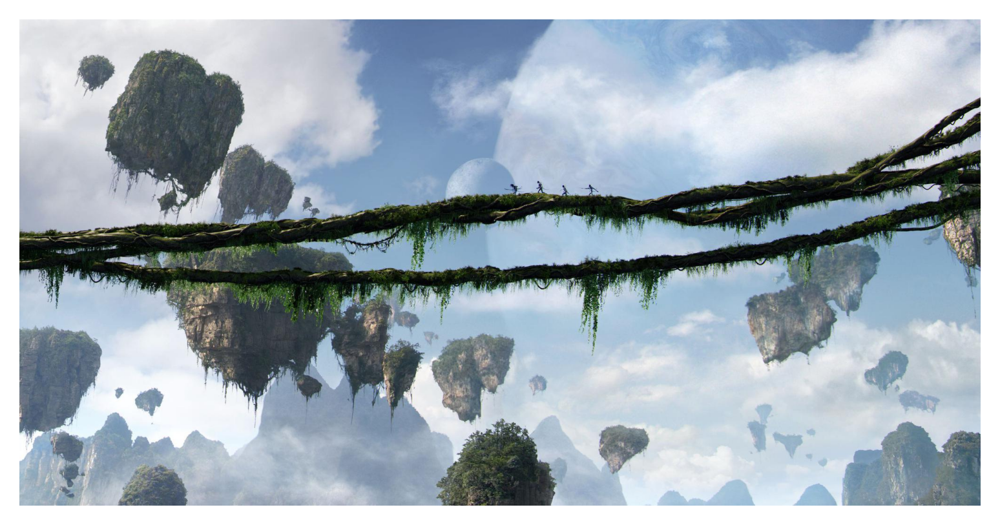

In [6]:
# 转变通道顺序为RGB
# img = img[:, :, -1] # 同样达到转换通道的效果
img = cv.cvtColor(img, cv.COLOR_BGR2RGB)
plt.figure(dpi=300)
plt.imshow(img)
plt.axis('off')
plt.show()  # 正常显示

### 使用OpenCV操作图像

In [7]:
img.dtype  # 查看图像数据类型

dtype('uint8')

可以看到，数值类型是uint8，uint8是专门为图像像素设置的数值类型，覆盖0-255之间的整数，uint8类型对图像数据的保护，其进行线性变换不是单调的，而是在0-255之间进行循环。如果要达到对图像进行处理的效果，就需要将数据类型转变为浮点型。一般由下面2种方式。

In [8]:
img * 1.0  # 乘1.0

array([[[236., 237., 239.],
        [236., 237., 239.],
        [236., 237., 239.],
        ...,
        [180., 197., 213.],
        [181., 198., 214.],
        [181., 198., 214.]],

       [[236., 237., 239.],
        [236., 237., 239.],
        [236., 237., 239.],
        ...,
        [185., 201., 217.],
        [187., 203., 219.],
        [188., 204., 220.]],

       [[236., 237., 239.],
        [236., 237., 239.],
        [236., 237., 239.],
        ...,
        [192., 205., 222.],
        [193., 206., 223.],
        [195., 208., 225.]],

       ...,

       [[161., 179., 193.],
        [162., 180., 194.],
        [164., 182., 196.],
        ...,
        [ 71.,  97., 120.],
        [ 70.,  96., 119.],
        [ 70.,  96., 119.]],

       [[162., 180., 194.],
        [163., 181., 195.],
        [164., 182., 196.],
        ...,
        [ 69.,  95., 118.],
        [ 69.,  95., 118.],
        [ 69.,  95., 118.]],

       [[163., 181., 195.],
        [163., 181., 195.],
        [165., 1

In [9]:
img / 255  # 归一化，数值转化为0-1之间，更推荐，可以减少计算量

array([[[0.9254902 , 0.92941176, 0.9372549 ],
        [0.9254902 , 0.92941176, 0.9372549 ],
        [0.9254902 , 0.92941176, 0.9372549 ],
        ...,
        [0.70588235, 0.77254902, 0.83529412],
        [0.70980392, 0.77647059, 0.83921569],
        [0.70980392, 0.77647059, 0.83921569]],

       [[0.9254902 , 0.92941176, 0.9372549 ],
        [0.9254902 , 0.92941176, 0.9372549 ],
        [0.9254902 , 0.92941176, 0.9372549 ],
        ...,
        [0.7254902 , 0.78823529, 0.85098039],
        [0.73333333, 0.79607843, 0.85882353],
        [0.7372549 , 0.8       , 0.8627451 ]],

       [[0.9254902 , 0.92941176, 0.9372549 ],
        [0.9254902 , 0.92941176, 0.9372549 ],
        [0.9254902 , 0.92941176, 0.9372549 ],
        ...,
        [0.75294118, 0.80392157, 0.87058824],
        [0.75686275, 0.80784314, 0.8745098 ],
        [0.76470588, 0.81568627, 0.88235294]],

       ...,

       [[0.63137255, 0.70196078, 0.75686275],
        [0.63529412, 0.70588235, 0.76078431],
        [0.64313725, 0

这样做带来的几个变化：
1. 图像的格式会从uint8变为float64,不再受到uint8类型的限制，可以允许负数、小数、超出255的整数，这让图像的变化变得单调，为了让图像显示正常，需要使用np.clip来控制图像的像素在0-255之间
2. 图像的计算会变得更快
3. float64无法被OpenCV进行转换或其他处理，只有需要手动操作图像的像素时，才会使用归一化，对图像归一化后，像素值越接近1就越亮，越接近0就越暗

下面进行图像的一些简单操作。

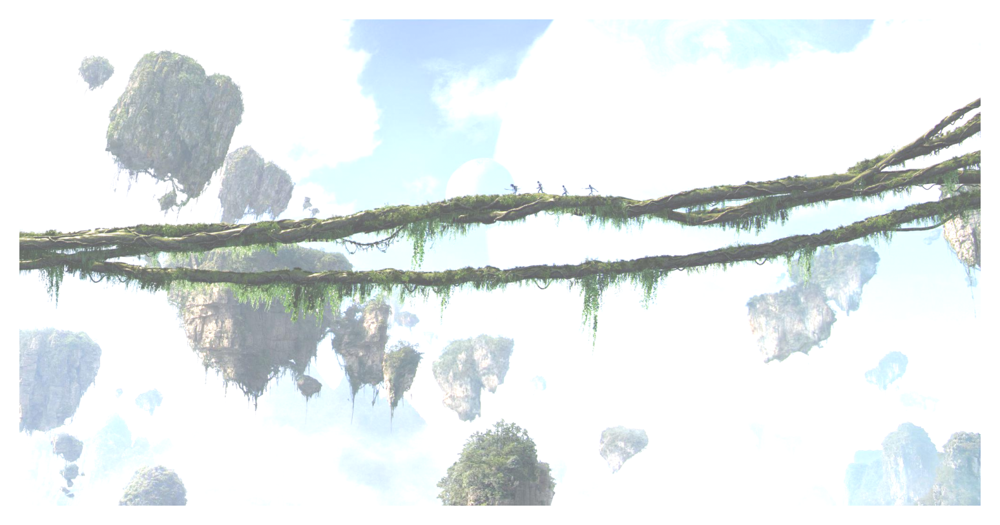

In [10]:
# 归一化
img_norm = img / 255

# 调亮画面
img_ = np.clip(img_norm + 100 / 255, 0, 1)
plt.figure(dpi=300)
plt.imshow(img_)
plt.axis('off')
plt.show()  # 更亮

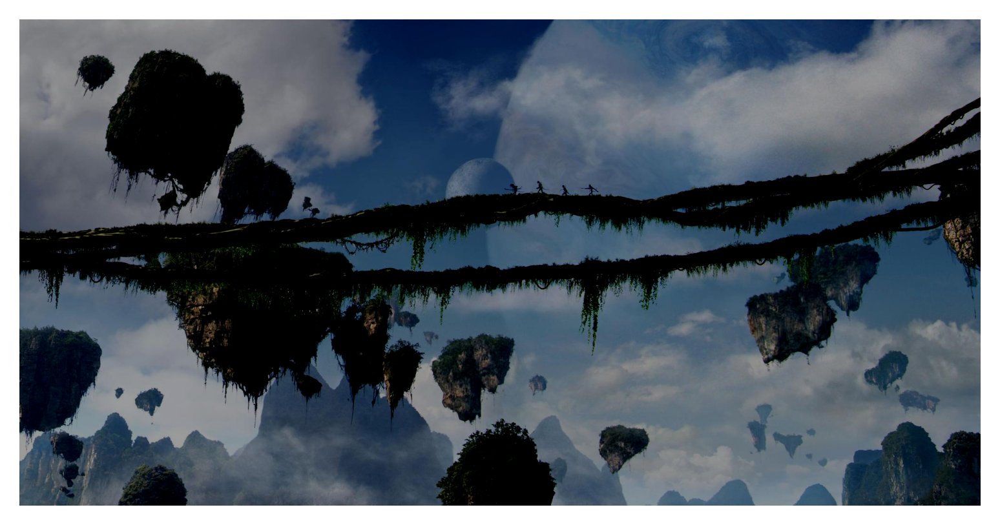

In [11]:
# 调暗画面
img_ = np.clip(img_norm - 100 / 255, 0, 1)
plt.figure(dpi=300)
plt.imshow(img_)
plt.axis('off')
plt.show()  # 更暗

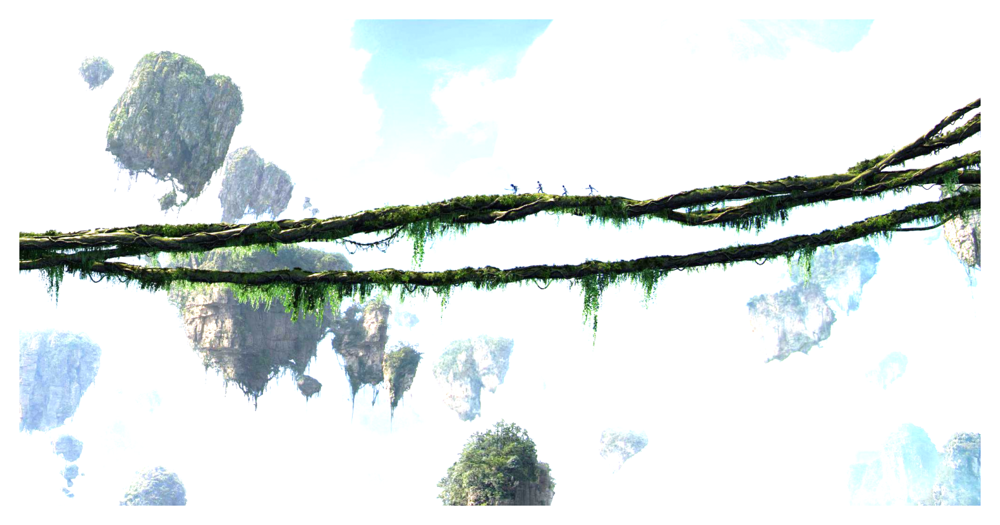

In [12]:
# 让画面更鲜艳
img_ = np.clip(img_norm * 2, 0, 1)
plt.figure(dpi=300)
plt.imshow(img_)
plt.axis('off')
plt.show()  # 更鲜艳

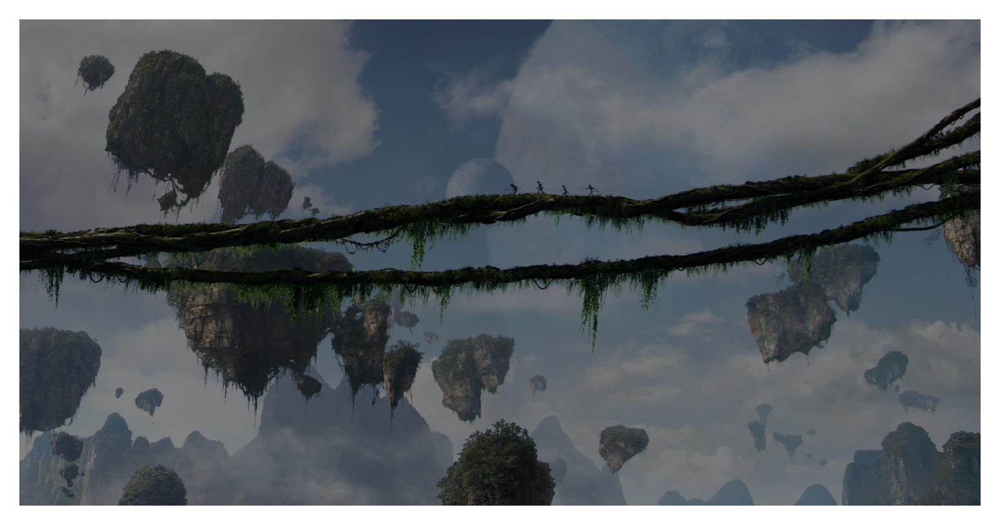

In [13]:
# 让画面更黯淡
img_ = np.clip(img_norm * 0.5, 0, 1)
plt.figure(dpi=300)
plt.imshow(img_)
plt.axis('off')
plt.show()  # 更黯淡

还可以将图像切换到其他色彩空间，来调整色相、饱和度和亮度。

In [14]:
img_hsv = cv.cvtColor(img, cv.COLOR_RGB2HSV)  # 将通道转换为HSV
h, s, v = cv.split(img_hsv)  # 切分HSV3个通道
h.shape, s.shape, v.shape

((1037, 2048), (1037, 2048), (1037, 2048))

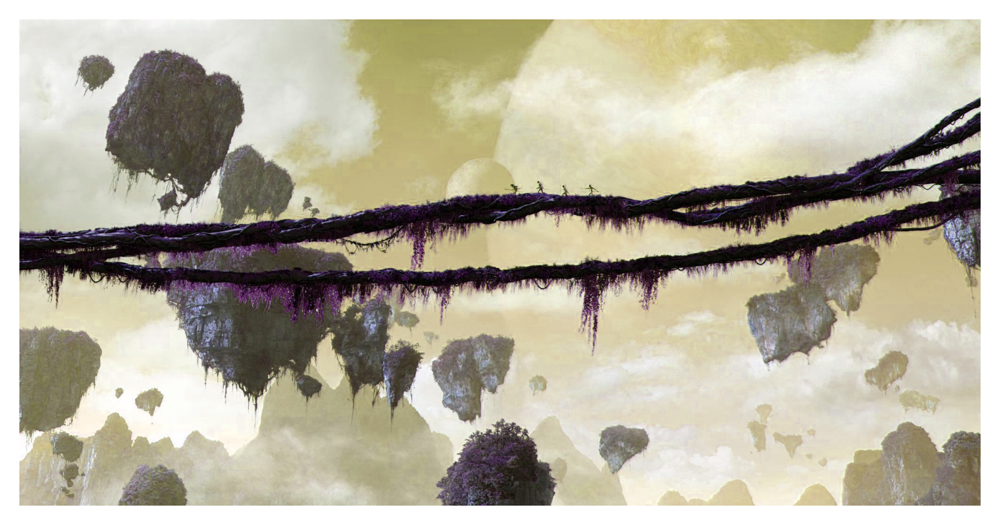

In [15]:
# 提升色相
h_ = np.clip(h * 1.0 + 100, 0, 255).astype('uint8')
img_hsv_ = cv.merge((h_, s, v))  # 合并新的HSV
img_ = cv.cvtColor(img_hsv_, cv.COLOR_HSV2RGB)  # 转回RGB通道
# 展示
plt.figure(dpi=300)
plt.imshow(img_)
plt.axis('off')
plt.show()  # 色相更好

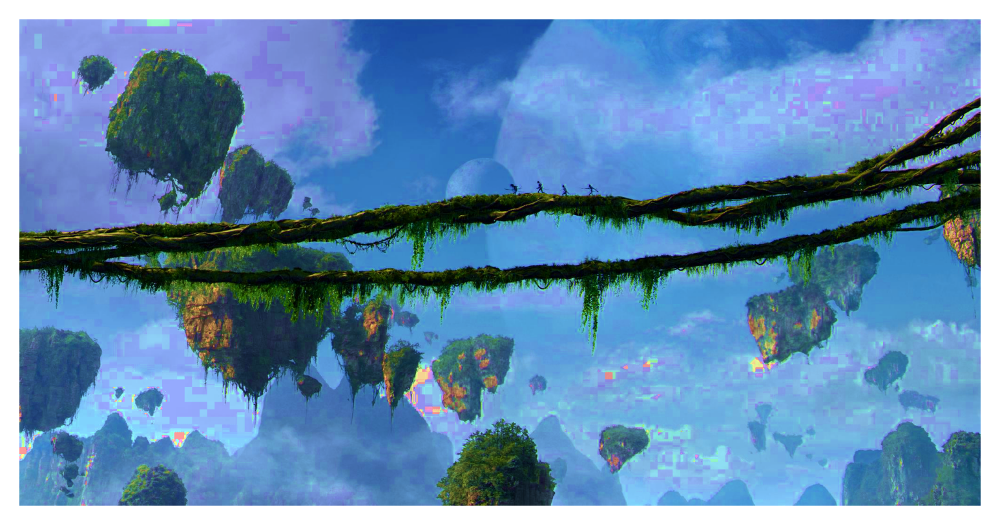

In [16]:
# 提升饱和度
s_ = np.clip(s * 1.0 + 100, 0, 255).astype('uint8')
img_hsv_ = cv.merge((h, s_, v))  # 合并新的HSV
img_ = cv.cvtColor(img_hsv_, cv.COLOR_HSV2RGB)  # 转回RGB通道
# 展示
plt.figure(dpi=300)
plt.imshow(img_)
plt.axis('off')
plt.show()  # 更加鲜艳

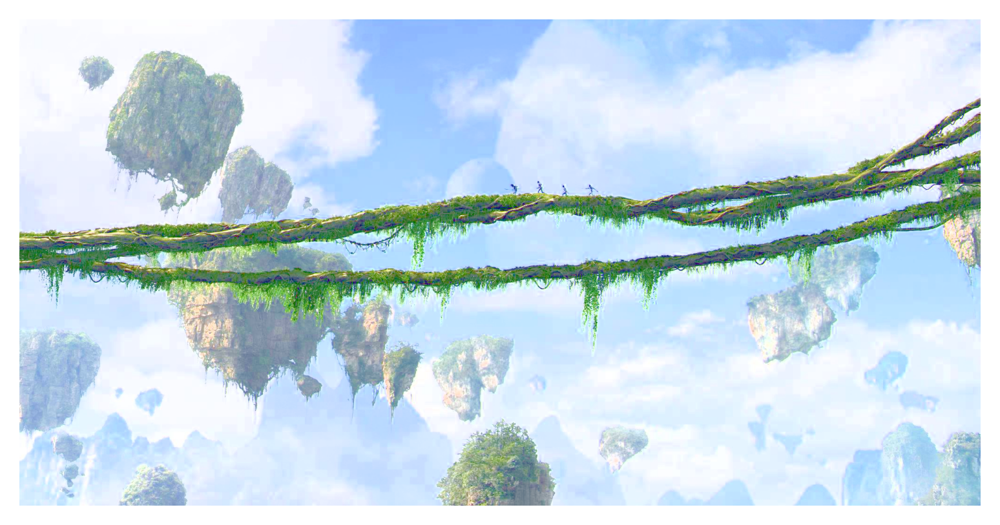

In [17]:
# 提升亮度
v_ = np.clip(v * 1.0 + 100, 0, 255).astype('uint8')
img_hsv_ = cv.merge((h, s, v_))  # 合并新的HSV
img_ = cv.cvtColor(img_hsv_, cv.COLOR_HSV2RGB)  # 转回RGB通道
# 展示
plt.figure(dpi=300)
plt.imshow(img_)
plt.axis('off')
plt.show()  # 更亮

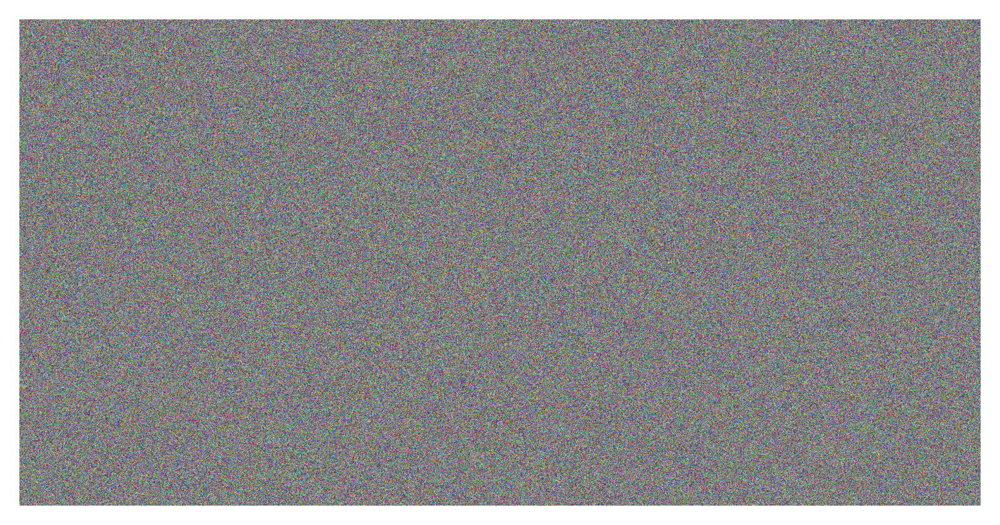

In [18]:
# 随机“瞎编”出一张图像
pic = np.random.randint(0, 255, size=img.shape)
# 展示
plt.figure(dpi=300)
plt.imshow(pic)
plt.axis('off')
plt.show()  # 无规则的噪声

由于灰度的存在，图像可以被表示成二元函数，通常写作$f(x, y)$或$f(i, j)$，函数的两个自变量是图像的某个点在宽度与高度的坐标，函数值就是该通道上的灰度值。由于图像可以被作为二元函数表示，调整亮度等操作也可以用数学的方式来表示：
$$
g(i, j)=\alpha \cdot f(i, j)+\beta
$$
其中，$g(i, j)$表示输出图像，$f(i, j)$表示输入图像，$\alpha$控制对比度，$\beta$控制亮度，这就是视觉领域最简单的线性变化。有了函数，就可以对图像的函数进行求导、积分等操作，这种表示大大拓宽了可以在图像上进行的操作，只要控制像素值的范围在[0,255]，就可以在图像上进行任意的数学变换。
## 3.从卷积到卷积神经网络
### 卷积操作
卷积操作是一种常见的数学计算，二维矩阵的卷积表示其中一个矩阵在平面上旋转180°后，与另一个矩阵求点积的结果。其中“卷”就是旋转、“积”就是点积，也就是加权求和。本质上来说，卷积就是其中一个矩阵旋转180°后，两个矩阵对应位置元素相乘再加和的结果。其一般公式如下：
$$
\left[\begin{array}{cccc}
x_{11} & x_{12} & \cdots & x_{1 n} \\
x_{21} & x_{22} & \cdots & x_{2 n} \\
\vdots & \vdots & \ddots & \vdots \\
x_{m 1} & x_{m 2} & \cdots & x_{m n}
\end{array}\right] *\left[\begin{array}{cccc}
y_{11} & y_{12} & \cdots & y_{1 n} \\
y_{21} & y_{22} & \cdots & y_{2 n} \\
\vdots & \vdots & \ddots & \vdots \\
y_{m 1} & y_{m 2} & \cdots & y_{m n}
\end{array}\right]=\sum_{i=0}^{m-1} \sum_{j=0}^{n-1} x_{(m-i)(n-j)} y_{(1+i)(1+j)}
$$
其中$x$表示其中一个矩阵的值，$y$表示另一个矩阵的值，$m$与$n$分别是两个矩阵的行数和列数。
以权重矩阵$
\left[\begin{array}{lll}
-1 & 0 & 1 \\
-2 & 0 & 2 \\
-1 & 0 & 1
\end{array}\right]
$对一个像素矩阵卷积操作为例说明卷积的操作过程。图像和权重矩阵如下：
![convolution_init](../assets/convolution_init.png)

进行卷积的过程如下：
![convolution_first](../assets/convolution_first.png)
![convolution_second](../assets/convolution_second.png)
...

![convolution_last](../assets/convolution_last.png)

此时，右侧的矩阵就是我们使用权重矩阵进行卷积计算的结果，得到了一张4X4尺寸的图像，且中间两列像素为40、两边为0，所以是中间较亮、两边较暗，原本的图像在中间有一条明显的“边界”，现在我们权重矩阵对这张图像进行卷积后得出的图“放大”了这个边界，让边界亮了起来，让其他地方变暗了，这就实现了对图像进行**边缘检测**。边缘检测是卷积操作的一个常见应用，上面所使用的权重矩阵其实是纵向的索贝尔算子（Sobel Operator），用于检测纵向的边缘，也可以使用横向的索贝尔算子和拉普拉斯算子来检测边缘。下面使用OpenCV进行实现。

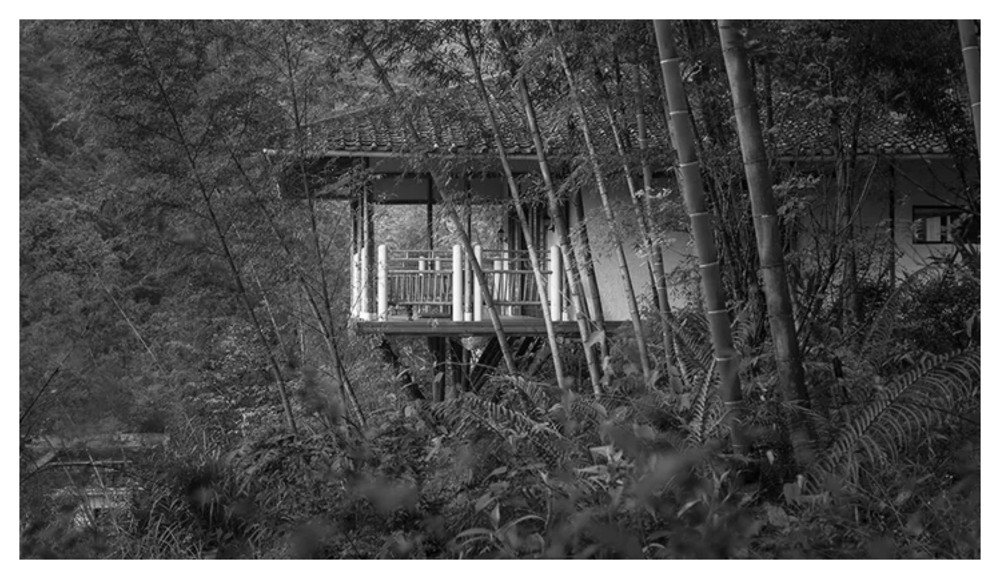

In [19]:
# 读取图片
img = cv.imread('../data/imgs/hut_in_bamboo_forest.png')
# 索贝尔等卷积操作在灰度图像上表现更好，因此导入图像时就转化为灰度图像
img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
# 查看原图
plt.figure(dpi=300)
plt.imshow(img, cmap='gray')  # cmap参数设置显示灰度图
plt.axis('off')
plt.show()

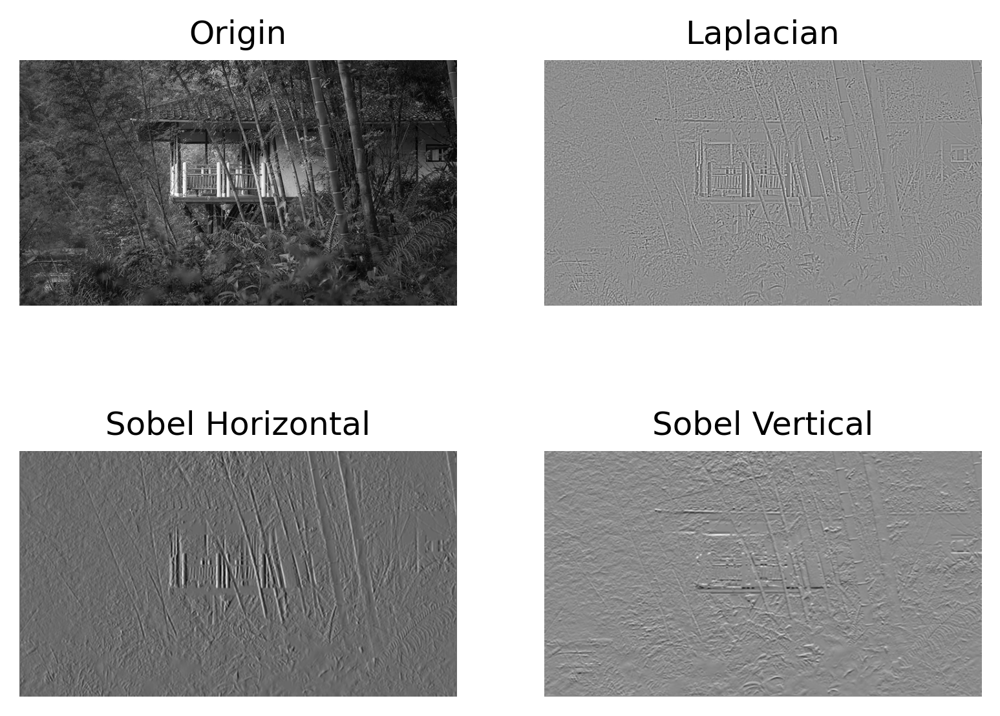

In [20]:
# 拉普拉斯算子
img_lap = cv.Laplacian(img, cv.CV_64F, ksize=5)  # cv2.CV_64F参数是一种数据格式，可以保证输出数据是uint8类型，ksize为权重矩阵的大小
# 索贝尔算子
img_sobel_h = cv.Sobel(img, cv.CV_64F, 1, 0, ksize=5)
img_sobel_v = cv.Sobel(img, cv.CV_64F, 0, 1, ksize=5)

# 显示图片
plt.figure(dpi=300)
plt.subplot(221)
plt.imshow(img, cmap='gray')
plt.title('Origin')
plt.axis('off')
plt.subplot(222)
plt.imshow(img_lap, cmap='gray')
plt.title('Laplacian')
plt.axis('off')
plt.subplot(223)
plt.imshow(img_sobel_h, cmap='gray')
plt.title('Sobel Horizontal')
plt.axis('off')
plt.subplot(224)
plt.imshow(img_sobel_v, cmap='gray')
plt.title('Sobel Vertical')
plt.axis('off')
plt.show()

可以看到，很好地检测到了图片中的横向或纵向的边缘。也可以使用其他权重矩阵与原图卷积来修改图像，例如锐化、模糊等，锐化的权重矩阵类似于$\left[\begin{array}{rrr}
0 & -1 & 0 \\
-1 & 5 & -1 \\
0 & -1 & 0
\end{array}\right]$，模糊的权重矩阵类似于$\frac{1}{9}\left[\begin{array}{lll}
1 & 1 & 1 \\
1 & 1 & 1 \\
1 & 1 & 1
\end{array}\right]$。

在进行卷积时，首先确立权重矩阵，然后将矩阵旋转180°之后再与感受野进行点积，这个过程叫做“卷积”，但在实际执行计算的时候，真正发挥作用的使旋转后的旋转矩阵，OpenCV中的Sobel和Laplacian函数也没有进行“旋转”、而是直接定义了旋转后矩阵，在今天的计算机视觉技术中，尤其是深度学习中，大部分时候也忽略了“旋转”。没有了旋转，只关心与图像相乘的旋转矩阵，把旋转矩阵的值称为权重，将该矩阵称为过滤器（filter，意为可以过滤出有效的特征）或卷积核（Convolution Kernel），每个卷积核在原图上扫描的区域（被标注为绿色的区域）被称为感受野（receiptive field），卷积核与感受野轮流点积得到的新矩阵被叫做特征图（feature map）或激活图（activation map）。当没有旋转，只有点积的时候，图像与矩阵之间的运算就不是数学上的卷积，而是**互相关**（cross-correlation）。
### 神经网络中的卷积
检测边缘、锐化、模糊、图像降噪等卷积相关的操作都可以被认为是在从图像中提取部分信息，因此也被称为**特征提取**，卷积操作后所产生的图像可以作为特征被后续任务使用，在传统计算机视觉领域，这一操作常常被认为可以增强计算机对图像的识别能力、提升模型表现。卷积的一个重要任务就是设计卷积核，对不同的操作和不同的图片需要设置不同的卷积核才能达到特征提取的效果，而不是一个卷积核对所有的图片都能起到明显的提取效果。例如拉普拉斯和索贝尔算子对对上一张图就无法获得理想的边缘检测效果，如下。

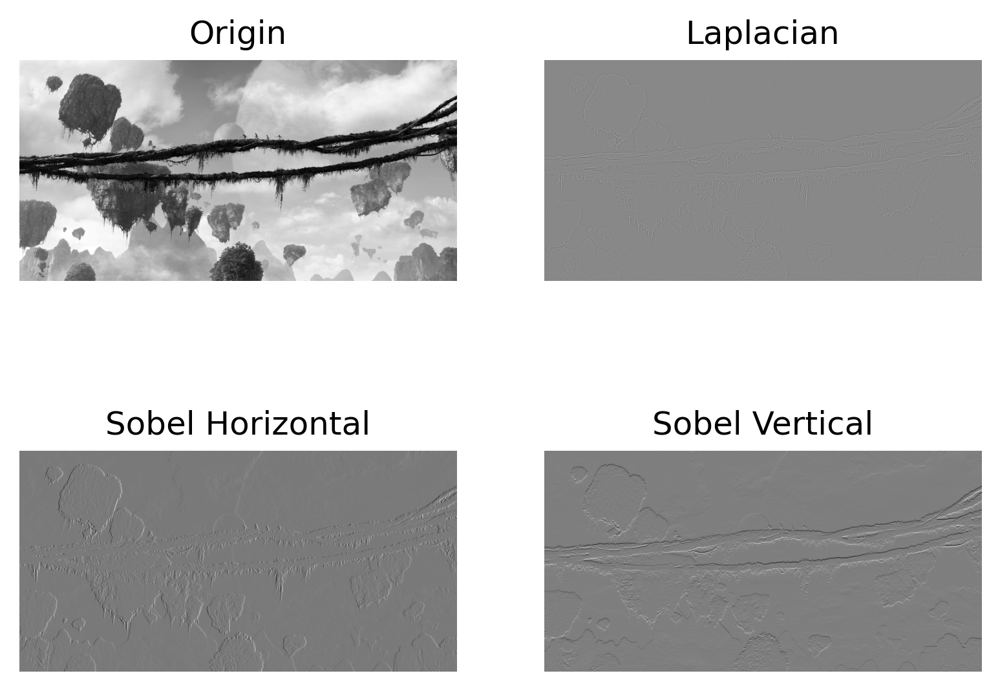

In [21]:
# 读取图片
img = cv.imread('../data/imgs/avatar_beauty.png')
# 转化为灰度图像
img = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
# 拉普拉斯算子
img_lap = cv.Laplacian(img, cv.CV_64F, ksize=5)
# 索贝尔算子
img_sobel_h = cv.Sobel(img, cv.CV_64F, 1, 0, ksize=5)
img_sobel_v = cv.Sobel(img, cv.CV_64F, 0, 1, ksize=5)

# 显示图片
plt.figure(dpi=300)
plt.subplot(221)
plt.imshow(img, cmap='gray')
plt.title('Origin')
plt.axis('off')
plt.subplot(222)
plt.imshow(img_lap, cmap='gray')
plt.title('Laplacian')
plt.axis('off')
plt.subplot(223)
plt.imshow(img_sobel_h, cmap='gray')
plt.title('Sobel Horizontal')
plt.axis('off')
plt.subplot(224)
plt.imshow(img_sobel_v, cmap='gray')
plt.title('Sobel Vertical')
plt.axis('off')
plt.show()

显然，此时拉普拉斯和索贝尔算子都没有很好地检测到边缘信息，这是因为索贝尔和拉普拉斯算子对边缘抓取的程度较轻，这样的抓取对于横平竖直的边缘、以及色彩差异较大的边缘有较好的效果，而对于色彩丰富、线条和细节非常多的图像，这两种算子就不太适用。因此，不同的图像必须使用不同的权重进行特征提取，同时还必须加深特征提取的深度，要实现这些目标，就要用到深度学习。

在深度神经网络中，层与层之间存在着连接上层与下层的权重系数，深度学习的核心思想之一就是给定算法训练目标，让算法自己朝着目标函数最小化的方向进行学习，并自动求解出权重系数的最佳组合。任意使用卷积层的神经网络就都可以称为卷积神经网络（Convolution Neural Network），每当卷积层被建立时，卷积核中的值就会被随机生成，输入图像的像素点与卷积核点积后，生成的特征图被输入到下一层网络，并最终变成预测标签被放入损失函数中进行计算，在使用优化算法进行迭代、损失足够低后，卷积核中的权重值就被自动学习出来，从而实现自动找出最佳权重、并提取出对分类最有利的特征。

卷积神经网络可以通过参数共享和稀疏交互来减少模型的参数数量，从而降低模型的复杂度和计算量：
1. 参数共享：卷积带来参数量骤减
    在CNN中，每个卷积核（Convolutional Kernel）在整个输入图像上移动时所用的权重是相同的，这种共享可以减少模型的参数数量，同时也能够提高模型的泛化能力，使得模型对于输入图像的变化具有一定的不变性。
2. 稀疏交互：获取更深入的特征
    在CNN中，每个卷积核只与输入图像中的一小部分区域进行交互，而不是与整个图像进行交互，即下层的一个神经元只和上层中被扫描的那些神经元有关。这种交互可以进一步减少模型的参数数量，并且可以提高模型的局部感知能力，使得模型能够更好地捕捉输入图像中的局部特征，让CNN获得了提取更深特征的能力。

通过参数共享和稀疏交互，CNN可以在保证模型性能的同时，大大减少模型的参数数量和计算量，从而使得CNN成为处理大规模图像数据的有力工具。CNN的“稀疏交互”属性允许神经元只包含上一层图像“局部”的信息，当图像被输入网络后，前端的卷积神经网络提取到的特征都是浅层的（和Sobel算子等方法一样），将这些浅层特征继续输入后续的网络，再次进行提取和学习，就能将浅层特征逐渐组合成深层特征，位于卷积神经网络架构后端的卷积层捕捉到更深层的特征，但是这样的深层特征可能与我们人类的视觉和认知中的深层不太一样。
## 4.PyTorch中使用卷积神经网络
卷积神经网络是使用卷积层的一组神经网络，在PyTorch中，卷积层作为构成神经网络的层，继承自nn.Module类。按照输入数据的维度，卷积层可以分为处理时序数据(samples, channels, length)的一维卷积（Conv1d）、处理图像数据的(samples, height, width, channels)的二维卷积（Conv2d）、处理视频数据(samples, frames, height, width, channels)的三维卷积（Conv3d）。其中，时序数据是存在时间维度、受时间影响的三维数据，常被用于循环神经网络中，但卷积也可以处理这种数据；视频数据则是由多张图像在时间轴上排列构成的，因此视频数据可以被看做是图像数据的序列，frames是“帧数”，即一个视频中图像的总数量。按照卷积的操作和效果，可分为普通卷积、转置卷积、延迟初始化的LazyConv等。

最常用的是处理图像的普通卷积nn.Conv2d类，包含的参数如下：
```python
in_channels (int): Number of channels in the input image
out_channels (int): Number of channels produced by the convolution
kernel_size (int or tuple): Size of the convolving kernel
stride (int or tuple, optional): Stride of the convolution. Default: 1
padding (int, tuple or str, optional): Padding added to all four sides of
    the input. Default: 0
padding_mode (string, optional): ``'zeros'``, ``'reflect'``,
    ``'replicate'`` or ``'circular'``. Default: ``'zeros'``
dilation (int or tuple, optional): Spacing between kernel elements. Default: 1
groups (int, optional): Number of blocked connections from input
    channels to output channels. Default: 1
bias (bool, optional): If ``True``, adds a learnable bias to the
    output. Default: ``True``
```
其中，参数groups和dilation分别代表着分组卷积（Grouped Convolution）与膨胀卷积（Dilated Convolution）。
### 卷积核尺寸：kernel_size
kernel_size是卷积层是最简单的参数，表示卷积核的尺寸，可输入整数或数组，输入整数则代表卷积核的形状为正方形，输入数组则代表卷积核的形状与数组一。卷积核的尺寸对整个卷积网络的参数量有很大的影响。

在使用经典架构时，经典架构的原始尺寸就是最好的尺寸，如果是自定义神经网络，一般情况下3x3几乎就是最好的选择。同时对卷积核的大小有以下几条不成文的规定：
1. 卷积核几乎都是正方形
2. 卷积核的尺寸最好是奇数，例如3x3、5x5等，这样可以让被扫描区域“中心对称”
3. 计算机视觉卷积核的尺寸往往都比较小，自然语言处理中卷积核尺寸可以很大

### 卷积的输入与输出：in_channels、out_channels、bias
in_channels是输入卷积层的图像的通道数或上一层传入特征图的数量，out_channels是指这一层输出的特征图的数量。

在1次扫描中，拥有同样尺寸、但不同数值的in_channels个卷积核会分别在输入通道上进行扫描，得出in_channels个相应的“新通道”。得出三个“新通道”后，将对应位置的元素相加，形成一张新图，这就是卷积层输入的1个特征图。一次扫描对应一个feature map，无关原始图像的通道数目是多少，而out_channels就是扫描次数，所以一次卷积操作的卷积核的数量就等于输入的通道数in_channels x 扫描次数（out_channels）。卷积核的作用是捕捉特征，同一个通道上一般会有多个不同的卷积核来捕捉不同位置的特征。feature maps被输入到下一个卷积层时，它也是被当作“通道”来处理的，新卷积层上对所有feature map完成之后，也会将它们的扫描结果加和成一个新feature map。卷积中的每个卷积层中也可以加入偏差bias，偏差的数量与扫描的数量一致，得到feature_map后，如果有偏差，会将偏差值加到feature_map的每个元素。

卷积层的输入是图像时，一次扫描会扫描所有通道的值再加和成一张特征图；卷积层的输入是上层的特征图时，特征图会被当做“通道”对待，一次扫描会扫描所有输入的特图，加和成新的feature map。无论在哪一层，生成的feature map的数量都等于这一层的扫描次数，也就是out_channels的值，下一层卷积的in_channels就等于上一层卷积的out_channels。下面实现卷积层的使用。

In [22]:
# 构造数据
images = torch.randint(0, 256, (16, 3, 28, 28), dtype=torch.float)  # NCHW
images.shape

torch.Size([16, 3, 28, 28])

In [23]:
# 定义第1个卷积层
conv1 = nn.Conv2d(  # 关键字传参，可以不按照顺序
    in_channels=3,  # 输入通道数
    out_channels=6,  # 输出通道数
    kernel_size=3  # 卷积核大小
)
# 前向传播
out = conv1(images)
out.shape

torch.Size([16, 6, 26, 26])

In [24]:
# 定义第2个卷积层
conv2 = nn.Conv2d(6, 10, 3)  # 位置传参，必须按照顺序
# 前向传播
out = conv2(out)
out.shape  # 张量尺寸逐渐减小

torch.Size([16, 10, 24, 24])

### 特征图的尺寸：stride、padding、padding_mode
在一般情况下，经过卷积操作之后，新生成的特征图的尺寸往往是小于上一层的特征图的。对于一个卷积神经网络而言，特征图的尺寸非常重要，它既不能太小，也不能太大。

在实际进行卷积操作时，每执行一次卷积时如果将感受野向右和向下移动一个像素，直到整张图片都被扫描完为止，这样执行一次卷积计算就需要扫描很久，并且其中有许多像素都是被扫描了很多次的，既浪费时间又浪费资源，此时引入stride（步长，或步幅），步长是每执行完一次卷积、或扫描完一整行后，向右、向下移动的像素数，水平方向的步长管理横向移动，竖直方向的步长管理纵向移动。步长可以根据自己的需求进行调整，通常都设置为1-3之间的数字，也可以根据kernel_size来进行设置。参数步长可以被用于**降维**，即可以让输入下一层的特征图像素量降低，特征图的尺寸变得更小。

卷积神经网络还容易出现扫描不完全或扫描不均衡的问题：在图像扫描到右边和下边时，如果剩下的像素不够卷积核的大小，就不得不舍弃掉没有扫描的最后一列像素，导致扫描不完全；如果步长小于卷积核的宽度和长度，则中间部分的像素就会在扫描的过程中被扫描多次，而边缘的像素则只会在每次感受野来到边缘时被扫描到，这就会导致“中间重边缘轻”，导致扫描不均衡。此时需要引入**填充法**对图像进行处理：在图像的四周使用0或其他数字填上一些像素，扩大图像的面积，使得卷积核能将整个图像尽量扫描完整。填充由参数padding控制和padding_mode控制：
- padding控制填充的圈数，接受大于0的正整数或数组作为参数，padding=1则时在原通道的上下左右方向各添上1个像素，通道的尺寸实际上会增加2*padding。
- padding_mode控制填充的内容，PyTorch提供了4种填充方式，zeros（零填充，默认方式）、reflect（镜像填充，以矩阵边缘为对称轴、将矩阵中的元素对称的填充到最外围）、replicate（重复填充，用边缘的像素值来填充）、circular（循环填充）。如果要使用径向填充和重复填充，也可以直接用nn.ReflectionPad和nn.ReplicationPad类。padding的值一般在1~3之间。

Padding并不能够保证图像一定被扫描完全或一定均衡，即使填充了像素，也会存在无法将整张图扫描完全的情况，此时有2种解决方案：
- valid：对于扫描不到的部分，直接丢弃
- same：无法对全图进行扫描时，对图像右侧和下边进行“再次填充”，直到可以完全扫描为止

实际上，对于分辨率很高、尺寸很大、像素点很多的图片来说，进行Padding时无法扫描时可以丢弃边缘，因为边缘像素包含关键信息的可能性很小，带来的信息损失也很小。但是对于尺寸很小的图片来说，丢失边缘可能会带来很大的信息损失，此时可以通过一些参数的设置来尽量避免未扫描的像素被丢弃：
- 卷积核尺寸控制在5x5以下，并且kernel_size > stride
- 保证2*padding > stride

加入了步长、填充之后，特征图的尺寸计算公式如下：
$$
H_{out}=\frac{H_{in}+2 P-K}{S}+1
$$
其中，卷积的操作都是以正方形为准，水平和竖直两个方向的值一致，$H_{out}$为特征图尺寸、$H_{in}$输入通道尺寸、$P$为填充圈数、$S$为步长。下面实现特征图的尺寸改变。

In [25]:
# 构造数据
images = torch.randint(0, 256, (16, 3, 28, 28), dtype=torch.float)  # NCHW
images.shape

torch.Size([16, 3, 28, 28])

In [26]:
# 第1个卷积层
conv1 = nn.Conv2d(3, 6, 3)
out = conv1(images)  # (28 + 2 * 0 - 3) // 1 + 1 = 26
out.shape  # (16, 6, 26, 26)

torch.Size([16, 6, 26, 26])

In [27]:
# 第2个卷积层
conv2 = nn.Conv2d(6, 10, 3)
out = conv2(out)  # (26 + 2 * 0 - 3) // 1 + 1 = 24
out.shape  # (16, 10, 24, 24)

torch.Size([16, 10, 24, 24])

In [28]:
# 第3个卷积层
conv3 = nn.Conv2d(10, 16, 5, stride=2, padding=1)
out = conv3(out)  # (24 + 2 * 1 - 5) // 2 + 1 = 11，图像无法被完全扫描，向下取整
out.shape  # (16, 16, 11, 11)

torch.Size([16, 16, 11, 11])

In [29]:
# 第4个卷积层
conv4 = nn.Conv2d(16, 10, 5, stride=3, padding=2, padding_mode='reflect')
out = conv4(out)  # (11 + 2 * 2 - 5) // 3 + 1 = 4
out.shape  # (16, 10, 4, 4)

torch.Size([16, 10, 4, 4])

In [30]:
# 第5个卷积层
conv5 = nn.Conv2d(10, 3, 5, stride=(2, 1), padding=2)
out = conv5(out)  # H: (4 + 2 * 2 - 5) // 2 + 1 = 2 W: (4 + 2 * 2 - 5) // 1 + 1 = 4
out.shape  # (16, 3, 2, 4)

torch.Size([16, 3, 2, 4])

## 5.池化层、BN2d与Dropout层
### 池化层
池化是一种非常简单（甚至有些粗暴）的降维方式，经常跟在卷积层之后，用以处理特征图,最常见的是最大池化（Max Pooling）和平均池化（AveragePooling）两种操作，最大池化选择感受野中的最大值作为新的特征图中的值、平均池化选择感受野中的平均值作为新的特征图中的值。池化层也有核，但它的核没有值，只有尺寸。池化核的移动也有步长stride，但默认步长就等于它的核尺寸，这样可以保证它在扫描特征图时不出现重叠。也可以设置参数令池化核的移动步长不等于核尺寸，称为Overlapping Pooling，即重叠池化。通常来说，对于特征图中每一个不重叠的、大小固定的矩阵，池化核都按照池化的标准对数字进行计算或筛选：最大池化选出扫描区域中最大的数字；平均池化中对扫描区域中所有的数字求平均；加和池化对扫描区域中所有的数字进行加和。最大池化是应用最广泛的，也是比较有效的，因为像素值越大，说明颜色信息越多，因此经过卷积层之后，像素值更高的点在原始图像上更有可能带有大量信息，MaxPooling通过摘取这些带有更多信息的像素点，有效地将冗余信息消除，实现了特征的提炼。

以MaxPool2d为例，其参数如下：
```python
kernel_size: the size of the window to take a max over
stride: the stride of the window. Default value is :attr:`kernel_size`
padding: implicit zero padding to be added on both sides
dilation: a parameter that controls the stride of elements in the window
return_indices: if ``True``, will return the max indices along with the outputs.
                Useful for :class:`torch.nn.MaxUnpool2d` later
ceil_mode: when True, will use `ceil` instead of `floor` to compute the output shape
```
池化层的特征图计算方式与卷积层类似，如下：
$$
H_{out}=\frac{H_{in}+2 P-K}{S}+1
$$
池化层的简单使用如下。

In [31]:
# 数据
images = torch.randint(0, 256, (16, 3, 28, 28), dtype=torch.float)

# 卷积层
conv = nn.Conv2d(3, 6, 5, stride=2, padding=1)
out = conv(images)  # (28 + 2 * 1 - 5) // 2 + 1 = 13
out.shape  # (16, 6, 13, 13)

torch.Size([16, 6, 13, 13])

In [32]:
# 池化层
pool = nn.MaxPool2d(2)  # 让图像的行和列都减半，像素量减少到1/4
out = pool(out)  # (13 + 2 * 0 - 2) // 2 + 1 = 6
out.shape  # (16, 6, 6, 6) # 不改变样本数和通道数

torch.Size([16, 6, 6, 6])

池化层将featrue map的行列进行缩减，使得整个feature map的像素数减少，是非常有效的降维方法。但是，杂使用池化层时，很多时候其实最关心的就是输出的特征图的尺寸，PyTorch也提供了自适应的相关类，可以实现指定输出特征图尺寸的池化，即`nn.AdaptiveMaxPool2d(output_size, return_indices)`和`nn.AdaptiveAvgPool2d(output_size)`，对于这两个类，可以输入output_size，池化层自动将特征图进行裁剪。使用如下。

In [33]:
# 卷积层
conv = nn.Conv2d(3, 6, 5, stride=2, padding=1)
out = conv(images)  # (28 + 2 * 1 - 5) // 2 + 1 = 13
out.shape  # (16, 6, 13, 13)

torch.Size([16, 6, 13, 13])

In [34]:
# 池化层
pool = nn.AdaptiveAvgPool2d(7)  # 让图像的行和列都缩减到7
out = pool(out)
out.shape  # (16, 6, 7, 7)

torch.Size([16, 6, 7, 7])

池化层的特点和作用如下：
1. 有效降低模型所需的计算量、去除冗余信息
2. 提供非线性变化，为模型带来一些活力
3. 有一定的平移不变性
4. 池化层所有的参数都是超参数，不涉及到任何可以学习的参数，这既是优点（增加池化层不会增加参数量），也是致命的问题（池化层不会随着算法一起进步）
5. 按照所有的规律对所有的feature map一次性进行降维，特征图不同其本质规律也不同，使用同样的规则进行降维会带来大估摸信息损失

### BatchNorm2d
BN是神经网络中非常经典的用于控制过拟合、提升模型泛化能力的技巧，在卷积神经网络中需要使用对应的二维BN，类及其参数为`nn.BatchNorm2d(num_features, eps=1e-5, momentum=0.1, affine=True, track_running_stats=True, device=None, dtype=None)`，BN2d的输入数据是四维图像数据，最重要的参数是num_features，在BatchNorm1d中，num_features代表了输入BN层的神经元个
数（特征数，列数），对于卷积网络来说，由于存在参数共享机制，必须以卷积核/特征图为单位来进行归一化，因此BatchNorm2d的num_features是上一层输出的特征图的数量。使用如下。

In [35]:
# 数据
images = torch.randint(0, 256, (16, 3, 28, 28), dtype=torch.float)

# 卷积层
conv = nn.Conv2d(3, 10, 5, padding=1, stride=2)
out = conv(images)  # (28 + 2 * 1 - 5) // 2 + 1 = 13
out.shape  # (16, 10, 13, 13)

torch.Size([16, 10, 13, 13])

In [36]:
# BN层
bn = nn.BatchNorm2d(10)
out = bn(out)  # BN层不改变数据形状，只改变数据的值
out.shape  # (16, 10, 13, 13)

torch.Size([16, 10, 13, 13])

In [37]:
# 查看BN层参数
bn.weight.shape, bn.bias.shape

(torch.Size([10]), torch.Size([10]))

可以看到，BN层带有$\gamma$和$\beta$参数，这两个参数的数量上一层输出的特征图的数量决定，例如对有10张特征图的数据进行归一化时，就需要使用10组不同的$\gamma$和$\beta$参数，总参数量为特征图数$10*2=20$。
### Dropout层
Dropout也能防止过拟合，是指在神经网络训练过程中，以概率p随机地“沉默”一部分神经元，当整体神经元数量为N时，Dropout层会随机选择p*N个神经元，让这些神经元的权重变为0，在这一次训练中不再有效，达到使神经元失活的效果。在每次训练中，都有一组随机挑选的神经元被沉默，这样会减弱全体神经元之间的联合适应性，减少过拟合的可能性。在进行测试时，Dropout会对所有神经元上的系数都乘以概率(1-p)，用以模拟在训练中这些神经元p的概率被丢弃的状况。图示如下：
![dropout_demo](../assets/dropout_demo.png)

对于卷积神经网络来说，需要使用的类是`nn.Dropout2d(p=0.5, inplace=False)`，最核心的参数是p，其输入数据也是四维数据。但是在卷积中，Dropout不是以神经元为单位执行“沉默”，而是以通道为单位执行“沉默”，即如果当前通道被选中，则是一次丢弃整个通道的神经元。因此，当通道数不多时，使用Dropout或Dropout中的p值太大都会让CNN丧失学习能力，造成欠拟合。通常来说，使用Dropout之后模型需要更多的迭代才能够收敛，所以总是从较小的p开始尝试，例如0.1、0.25，最多使用p=0.5，否则模型的学习能力会出现明显下降。同时，Dropout层本身不带有任何需要学习的参数，因此不会影响参数总量。使用如下。

In [38]:
# 数据
images = torch.randint(0, 256, (16, 3, 28, 28), dtype=torch.float)

# 卷积层
conv = nn.Conv2d(3, 10, 3, padding=2, stride=2)
out = conv(images)  # (28 + 2 * 2 - 3) // 2 + 1 = 15
out.shape  # (16, 10, 15, 15)

torch.Size([16, 10, 15, 15])

In [39]:
dp = nn.Dropout2d(0.5)
out = dp(out)  # Dropout不会改变特征图的形状，只会改变数值
out.shape  # (16, 10, 15, 15)

torch.Size([16, 10, 15, 15])